# Superimposing synthetic exoplanets on NASA Solar Dynamics Observatory images of the solar surface

Here's some code to help create beautiful, high-resolution, publication-quality images of synthetic exoplanets superimposed on continuum intensity images of the solar surface taken by the [Helioseismic and Magnetic Imager](http://hmi.stanford.edu/) instrument, or HMI, aboard the [Solar Dynamics Observatory](https://sdo.gsfc.nasa.gov/). </br>

Import some modules and define some color tables:

In [1]:
import json, urllib, numpy as np, matplotlib.pylab as plt, math, matplotlib.ticker as mtick
from astropy.io import fits
from sunpy.cm import color_tables as ct
import matplotlib.image as mpimg
from matplotlib.cm import register_cmap, cmap_d
from datetime import datetime as dt_obj
from matplotlib.dates import *
from matplotlib import gridspec
import matplotlib.patches
from matplotlib.patches import Circle
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredDrawingArea
import sunpy.wcs as wcs
import requests
import drms
from astropy.constants import R_sun, R_earth
%matplotlib inline
import sunpy.map
%config InlineBackend.figure_format='retina'

In [2]:
ds9heat = {'red': lambda v : np.interp(v, [0, 0.34, 1], [0, 1, 1]),
           'green': lambda v : np.interp(v, [0, 1], [0, 1]),
           'blue': lambda v : np.interp(v, [0, 0.65, 0.98, 1], [0, 0, 1, 1])}
register_cmap('ds9heat', data=ds9heat)

Use the [drms module](https://drms.readthedocs.io/en/stable/) to download HMI data:

In [3]:
c = drms.Client()

# Grab the data
keys_hmi, segments = c.query('hmi.Ic_720s_dcons[2018.01.21_19:36:00_TAI]', key=drms.const.all, seg='continuum')
url_hmi = 'http://jsoc.stanford.edu' + segments.continuum[0]   # add the jsoc.stanford.edu suffix to the segment name
continuum_full_image = fits.getdata(url_hmi)                 # download the data

And create a synthetic Earth-sized exoplanet:

In [4]:
R_earth_arcsec = ((R_earth*keys_hmi.RSUN_OBS[0])/(R_sun))
R_earth_pixel = R_earth_arcsec / keys_hmi.CDELT1[0]
print(R_earth_pixel)

17.729796857528676


Use the SunPy map object to make an image with the axes and color bar labelled:

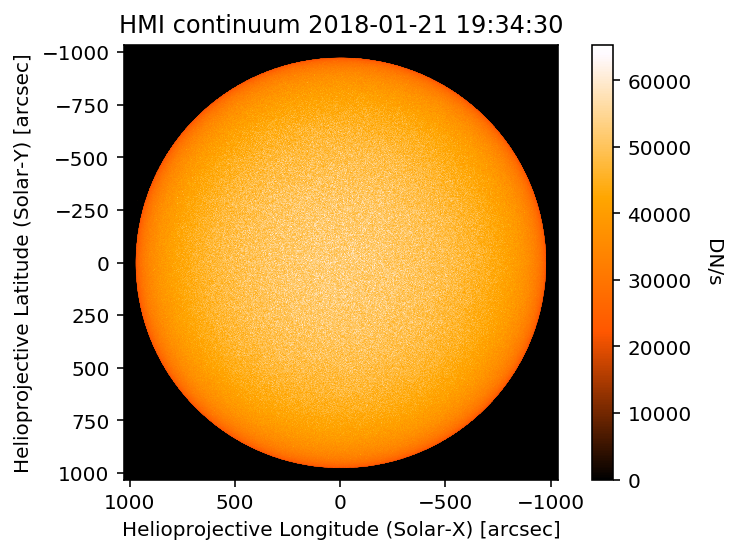

In [5]:
header = dict(keys_hmi.iloc[0])
# Add a DATE-OBS keyword which seems to be required by sunpy.map.Map.
header['DATE-OBS'] = keys_hmi.DATE__OBS[0]

# Add HGLN_OBS keyword to avoid a warning in sunpy.map.Map.
header['HGLN_OBS'] = 0.0
smap = sunpy.map.Map(continuum_full_image, header)

fig, ax = plt.subplots()
ax.set_facecolor('black')
im = smap.plot(cmap='ds9heat')
#ax.set_title('Custom plot without WCSAxes')
cbar = plt.colorbar()
cbar.set_label('DN/s', rotation=270, labelpad=15)
# plt.show()
fig.savefig('continuum0.png',bbox_inches='tight')

Here is the image in full resolution on its own, with no axes labelling or colorbar:

In [6]:
# dpi for retina display
# detect monitor dpi automatically here: http://www.infobyip.com/detectmonitordpi.php
my_dpi=192
fig = plt.figure(figsize=(4096.0/my_dpi, 4096.0/my_dpi), dpi=my_dpi, frameon=False)
ax = fig.add_subplot(1,1,1)
fig.subplots_adjust(left=0,right=1,top=1,bottom=0)
ax.get_xaxis().set_ticks([])
ax.get_yaxis().set_ticks([])
ax.set_facecolor('black')

# draw a box using matplotlib.patches.Rectangle
ax.add_patch(Circle((2048,2048), radius=R_earth_pixel, fill=True, color='Black', snap=False))

plt.imshow(continuum_full_image,cmap='ds9heat',origin='lower',interpolation='nearest', vmax=65000, vmin=0)
fig.savefig('continuum1.png')

In [7]:
continuum_partial_image = continuum_full_image[1920:2176,1920:2176]
print(continuum_partial_image.shape)

(256, 256)


Here is a zoomed-in patch where the granulation cells are clearly visible:

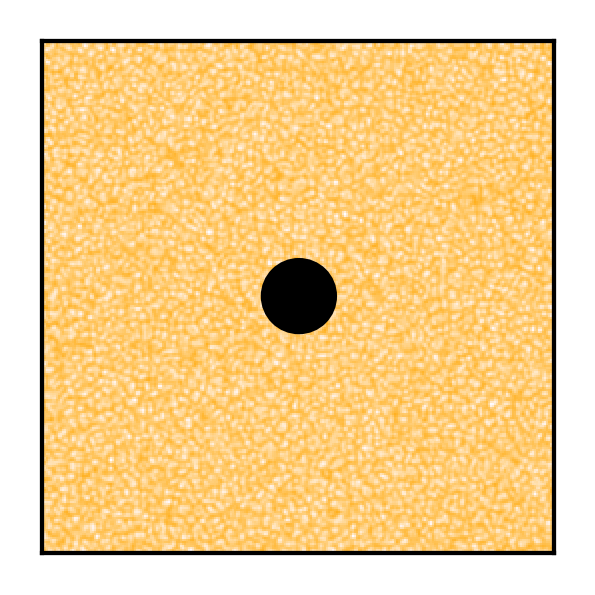

In [8]:
# dpi for retina display
# detect monitor dpi automatically here: http://www.infobyip.com/detectmonitordpi.php
my_dpi=192
fig = plt.figure(figsize=(256.0/my_dpi, 256.0/my_dpi), dpi=my_dpi, frameon=False)
ax = fig.add_subplot(1,1,1)
fig.subplots_adjust(left=0,right=1,top=1,bottom=0)
ax.get_xaxis().set_ticks([])
ax.get_yaxis().set_ticks([])
ax.set_facecolor('black')

# draw a box using matplotlib.patches.Rectangle
ax.add_patch(Circle((128,128), radius=R_earth_pixel, fill=True, color='Black', snap=False))


plt.imshow(continuum_partial_image,cmap='ds9heat',origin='lower',interpolation='nearest', vmax=65000, vmin=0)
fig.savefig('continuum_partial.png')